<a href="https://colab.research.google.com/github/AJ-Abisola/EDA/blob/main/EDA_Finance_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Finance Data Analysis

*By AJ ABISOLA*

*In this data project, I will focus on exploratory data analysis of stock prices. It is not meant to be a robust financial analysis or be taken as financial advice.*


### The Imports


In [ ]:
from pandas_datareader import data, wb
import pandas as pd
import numpy as np
import datetime
%matplotlib inline
import matplotlib.pyplot as plt

## Data

*We need to get data using pandas datareader. We will get stock information for the following banks:*
*  *Bank of America*
* *CitiGroup*
* *Goldman Sachs*
* *JPMorgan Chase*
* *Morgan Stanley*
* *Wells Fargo*

In [ ]:
start = datetime.date(2006,1,1)
end = datetime.date(2016,1,1)

In [ ]:
import requests_cache

session = requests_cache.CachedSession(cache_name='cache', backend='sqlite')

# just add headers to your session and provide it to the reader
session.headers = {     'User-Agent': 'Mozilla/5.0 (X11; Ubuntu; Linux x86_64; rv:89.0) Gecko/20100101 Firefox/89.0',     'Accept': 'application/json;charset=utf-8'     }


In [ ]:
# Bank of America
BAC = data.DataReader("BAC", 'yahoo', start, end,session=session)

# CitiGroup
C = data.DataReader("C", 'yahoo', start, end,session=session)

# Goldman Sachs
GS = data.DataReader("GS", 'yahoo', start, end,session=session)

# JPMorgan Chase
JPM = data.DataReader("JPM", 'yahoo', start, end,session=session)

# Morgan Stanley
MS = data.DataReader("MS", 'yahoo', start, end,session=session)

# Wells Fargo
WFC = data.DataReader("WFC", 'yahoo', start, end,session=session)

In [ ]:
# Could also do this for a Panel Object
df = data.DataReader(['BAC', 'C', 'GS', 'JPM', 'MS', 'WFC'],'yahoo', start, end, session=session)
df.head()

Attributes  Adj Close                                                \
Symbols           BAC           C          GS        JPM         MS   
Date                                                                  
2006-01-03  33.777500  365.387573  103.255730  26.345469  33.464508   
2006-01-04  33.418777  358.641785  101.829514  26.193415  33.487461   
2006-01-05  33.461834  360.420898  101.789429  26.272764  33.579288   
2006-01-06  33.411621  360.420898  103.231674  26.457861  33.613720   
2006-01-09  33.433125  358.715820  104.473640  26.887600  33.969540   

Attributes                 Close                                     ...  \
Symbols           WFC        BAC           C          GS        JPM  ...   
Date                                                                 ...   
2006-01-03  20.353493  47.080002  492.899994  128.869995  40.189999  ...   
2006-01-04  20.117414  46.580002  483.799988  127.089996  39.619999  ...   
2006-01-05  20.095083  46.639999  486.200012  127.040001  39.740002  ...   
2006-01-06  20.213118  46.570000  486.200012  128.839996  40.020000  ...   
2006-01-09  20.209921  46.599998  483.899994  130.389999  40.669998  ...   

Attributes        Open                                       Volume  \
Symbols             GS        JPM         MS        WFC         BAC   
Date                                                                  
2006-01-03  126.699997  39.830002  57.169998  31.600000  16296700.0   
2006-01-04  127.349998  39.779999  58.700001  31.799999  17757900.0   
2006-01-05  126.000000  39.610001  58.549999  31.500000  14970700.0   
2006-01-06  127.290001  39.919998  58.770000  31.580000  12599800.0   
2006-01-09  128.500000  39.880001  58.630001  31.674999  15619400.0   

Attributes                                                           
Symbols             C         GS         JPM         MS         WFC  
Date                                                                 
2006-01-03  1537600.0  6188700.0  12838600.0  5377000.0  11016400.0  
2006-01-04  1870960.0  4861600.0  13491500.0  7977800.0  10870000.0  
2006-01-05  1143160.0  3717400.0   8109400.0  5778000.0  10158000.0  
2006-01-06  1370210.0  4319600.0   7966900.0  6889800.0   8403800.0  
2006-01-09  1680740.0  4723500.0  16575200.0  4144500.0   5619600.0  

[5 rows x 36 columns]

In [ ]:
#Creating a list of the ticker symbols (as strings) in alphabetical order

tickers = ['BAC', 'C', 'GS', 'JPM', 'MS', 'WFC']

In [ ]:
#Concatenating the bank dataframes together to a single data frame

bank_stocks = pd.concat([BAC, C, GS, JPM, MS, WFC],axis=1,keys=tickers)

In [ ]:
bank_stocks.columns.names = ['Bank Ticker','Stock Info']

In [ ]:
#Check first five rows

bank_stocks.head()

Bank Ticker        BAC                                               \
Stock Info        High        Low       Open      Close      Volume   
Date                                                                  
2006-01-03   47.180000  46.150002  46.919998  47.080002  16296700.0   
2006-01-04   47.240002  46.450001  47.000000  46.580002  17757900.0   
2006-01-05   46.830002  46.320000  46.580002  46.639999  14970700.0   
2006-01-06   46.910000  46.349998  46.799999  46.570000  12599800.0   
2006-01-09   46.970001  46.360001  46.720001  46.599998  15619400.0   

Bank Ticker                      C                                      ...  \
Stock Info   Adj Close        High         Low        Open       Close  ...   
Date                                                                    ...   
2006-01-03   33.777500  493.799988  481.100006  490.000000  492.899994  ...   
2006-01-04   33.418777  491.000000  483.500000  488.600006  483.799988  ...   
2006-01-05   33.461834  487.799988  484.000000  484.399994  486.200012  ...   
2006-01-06   33.411621  489.000000  482.000000  488.799988  486.200012  ...   
2006-01-09   33.433125  487.399994  483.000000  486.000000  483.899994  ...   

Bank Ticker         MS                                         WFC             \
Stock Info        Open      Close     Volume  Adj Close       High        Low   
Date                                                                            
2006-01-03   57.169998  58.310001  5377000.0  33.464508  31.975000  31.195000   
2006-01-04   58.700001  58.349998  7977800.0  33.487461  31.820000  31.365000   
2006-01-05   58.549999  58.509998  5778000.0  33.579288  31.555000  31.309999   
2006-01-06   58.770000  58.570000  6889800.0  33.613720  31.775000  31.385000   
2006-01-09   58.630001  59.189999  4144500.0  33.969540  31.825001  31.555000   

Bank Ticker                                               
Stock Info        Open      Close      Volume  Adj Close  
Date                                                      
2006-01-03   31.600000  31.900000  11016400.0  20.353493  
2006-01-04   31.799999  31.530001  10870000.0  20.117414  
2006-01-05   31.500000  31.495001  10158000.0  20.095083  
2006-01-06   31.580000  31.680000   8403800.0  20.213118  
2006-01-09   31.674999  31.674999   5619600.0  20.209921  

[5 rows x 36 columns]

# EDA

***Let's explore the data a bit!***

In [ ]:
# Maximum Close price for each bank's stock

bank_stocks.xs(key='Close',axis=1,level='Stock Info').max()

Bank Ticker
BAC     54.900002
C      564.099976
GS     247.919998
JPM     70.080002
MS      89.300003
WFC     58.520000
dtype: float64

***Lets check the returns for each stocks and create a dataframe to for that.Returns are typically defined by:***

$$r_t = \frac{p_t - p_{t-1}}{p_{t-1}} = \frac{p_t}{p_{t-1}} - 1$$

In [ ]:
returns = pd.DataFrame()

***We can use pandas pct_change() method on the Close column to create a column representing this return value.***

In [ ]:
for tick in tickers:
    returns[tick+' Return'] = bank_stocks[tick]['Close'].pct_change()
returns.head()

,BAC Return,C Return,GS Return,JPM Return,MS Return,WFC Return
Date,,,,,,
2006-01-03,NaN,NaN,NaN,NaN,NaN,NaN
2006-01-04,-0.010620,-0.018462,-0.013812,-0.014183,0.000686,-0.011599
2006-01-05,0.001288,0.004961,-0.000393,0.003029,0.002742,-0.001110
2006-01-06,-0.001501,0.000000,0.014169,0.007046,0.001025,0.005874
2006-01-09,0.000644,-0.004731,0.012030,0.016242,0.010586,-0.000158


***The first date has no returns, which is expected. Lets create a pairplot of all stocks returns.***

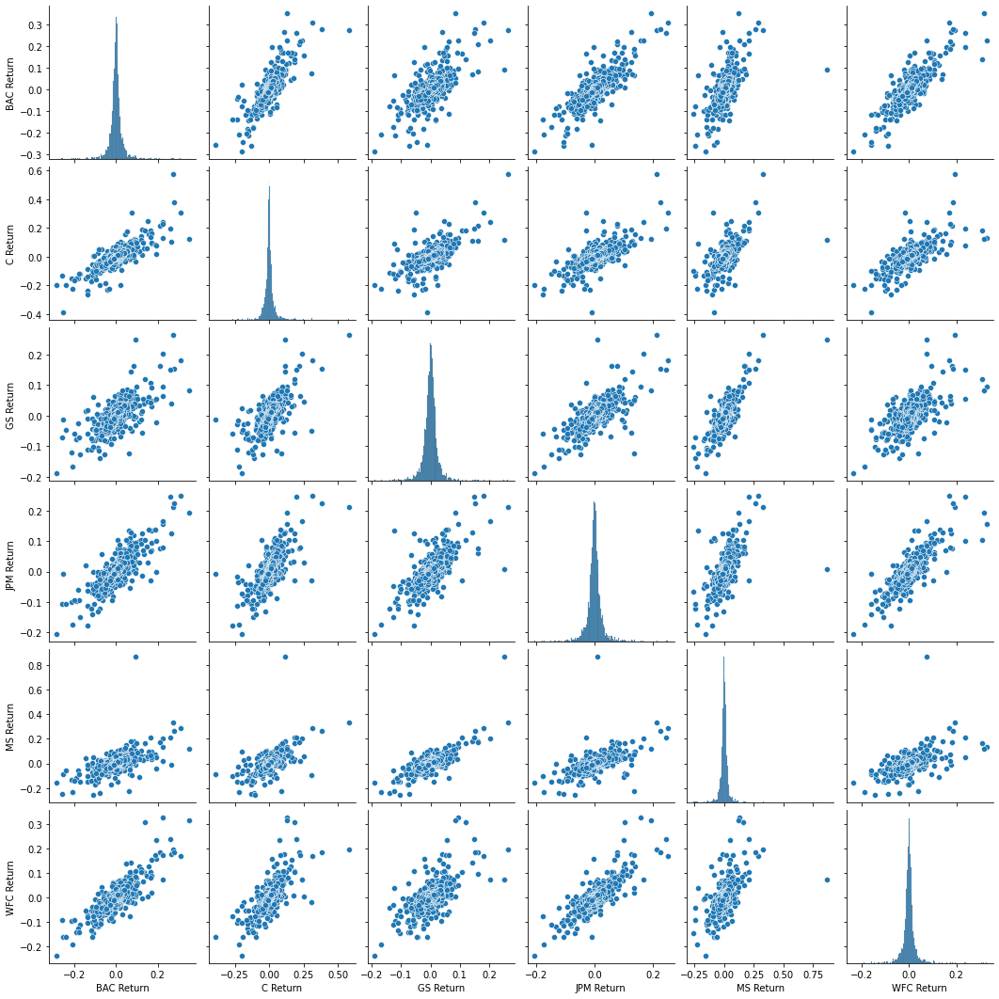

In [ ]:
#returns[1:]
import seaborn as sns
sns.pairplot(returns[1:])

***Citi Group Returns seems to stand out among others. Let's see if we can find out why from more exploration.***

Background on [Citigroup's Stock Crash available here.](https://en.wikipedia.org/wiki/Citigroup#November_2008.2C_Collapse_.26_US_Government_Intervention_.28part_of_the_Global_Financial_Crisis.29) 

You'll also see the enormous crash in value if you take a look a the stock price plot (which we do later in the visualizations.)

***Lets find out on what dates each bank stock had the best and worst single day returns.***

In [ ]:
# Worst Drop

returns.idxmin()

BAC Return   2009-01-20
C Return     2009-02-27
GS Return    2009-01-20
JPM Return   2009-01-20
MS Return    2008-10-09
WFC Return   2009-01-20
dtype: datetime64[ns]

***Four of them experienced a minimum on the same date; the 20th of January 2019. This happens to be the [Inauguration day](https://www.google.com/search?q=inauguration+day).***

***However, Citi Group had a different day as minimum. Lets check the max.***

In [ ]:
# Best Single Day Gain

returns.idxmax()

BAC Return   2009-04-09
C Return     2008-11-24
GS Return    2008-11-24
JPM Return   2009-01-21
MS Return    2008-10-13
WFC Return   2008-07-16
dtype: datetime64[ns]

***Citi Group's worst drop and best gain happened within the space of a few days(May 6th and May 9th, 2011). It means something significant must have happened during this period. [Citigroup had a stock split!](https://www.google.com/webhp?sourceid=chrome-instant&ion=1&espv=2&ie=UTF-8#q=citigroup+stock+2011+may)***

***JP Morgan Chase also experiences some similar with the worst and best days(January 20th and January 21st,2009) being a  day apart. They also had a stock split.***

***Now Lets see which stock appears the riskiest over a time period.***

In [ ]:
#Check standard deviation

returns.std() 

BAC Return    0.036647
C Return      0.038672
GS Return     0.025390
JPM Return    0.027667
MS Return     0.037819
WFC Return    0.030238
dtype: float64

***Citi Group apppears the riskiest with the highest the standard deviation***

In [ ]:
returns.loc['2015-01-01':'2015-12-31'].std() 

BAC Return    0.016163
C Return      0.015289
GS Return     0.014046
JPM Return    0.014017
MS Return     0.016249
WFC Return    0.012591
dtype: float64

***Morgan Stanley apppears the riskiest in 2015 with the highest the standard deviation***

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Distplot of Morgan Stanley Returns (2015)')

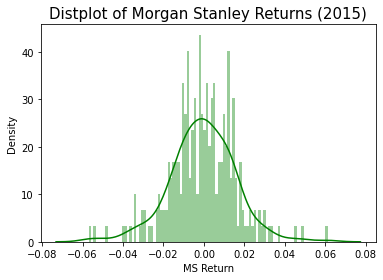

In [ ]:
#Creating a distribution plot of Morgan stanley returns for 2015

sns.distplot(returns.loc['2015-01-01':'2015-12-31']['MS Return'],color='green',bins=100)

plt.title('Distplot of Morgan Stanley Returns (2015)', fontdict={'size':15})

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0.5, 1.0, 'Distplot of Citi Group Returns (2008)')

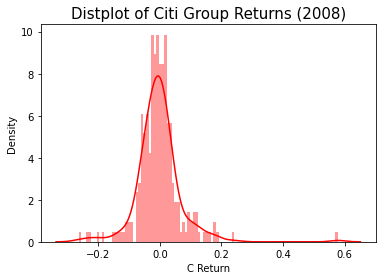

In [ ]:
#Creating a distribution plot of Citi Group returns for 2008

sns.distplot(returns.loc['2008-01-01':'2008-12-31']['C Return'],color='red',bins=100)
plt.title('Distplot of Citi Group Returns (2008)', fontdict={'size':15})

____
# More Visualization

### Imports

In [ ]:
sns.set_style('whitegrid')
%matplotlib inline


import plotly
import cufflinks as cf
cf.go_offline()

def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)

Text(0.5, 1.0, 'Plot of Close Price')

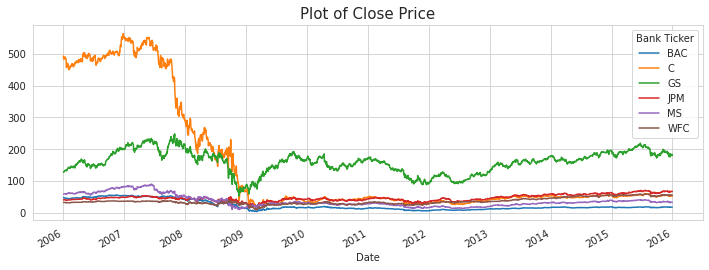

In [ ]:
#Creating a plot for close price over entire period in data

bank_stocks.xs(key='Close',axis=1,level='Stock Info').plot(figsize=(12,4))
plt.title('Plot of Close Price', fontdict={'size':15})

In [ ]:
#Creating an Interactive Plot of Close price 

enable_plotly_in_cell()
bank_stocks.xs(key='Close',axis=1,level='Stock Info').iplot()

***A significant drop is noted in 2009 for most stocks,as already established previously due to inuaguration day.***

## Moving Averages

Text(0.5, 1.0, '30 days Moving average for Bank of America')

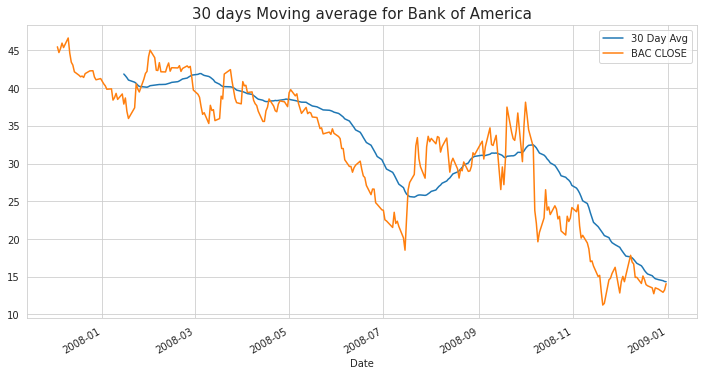

In [ ]:
#Creating a Plot of the rolling 30 day average against the Close Price for Bank Of America's stock for the year 2008

plt.figure(figsize=(12,6))
BAC['Close'].loc['2007-12-01':'2009-01-01'].rolling(window=30).mean().plot(label='30 Day Avg')
BAC['Close'].loc['2007-12-01':'2009-01-01'].plot(label='BAC CLOSE')
plt.legend()
plt.title('30 days Moving average for Bank of America', fontdict={'size':15})

Text(0.5, 1.0, '30 days Moving average for Bank of America')

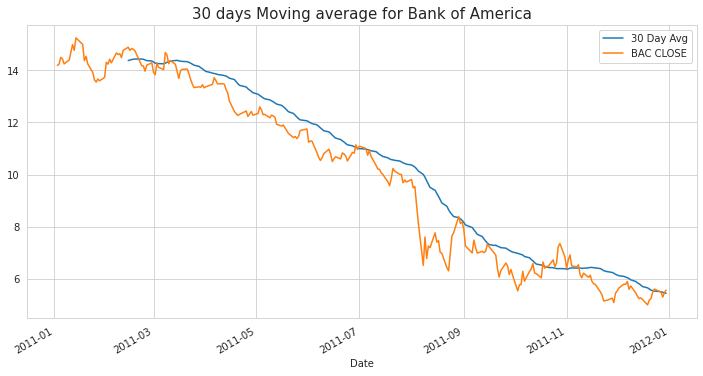

In [ ]:
#Creating a plot of the rolling 30 day average against the Close Price for Citi Group's stock for the year 2011

plt.figure(figsize=(12,6))
BAC['Close'].loc['2011-01-01':'2012-01-01'].rolling(window=30).mean().plot(label='30 Day Avg')
BAC['Close'].loc['2011-01-01':'2012-01-01'].plot(label='BAC CLOSE')
plt.legend()
plt.title('30 days Moving average for Bank of America', fontdict={'size':15})

***Lets see if there is any relationship betweeen the stocks***

Text(0.5, 1.0, 'Heatmap of stocks')

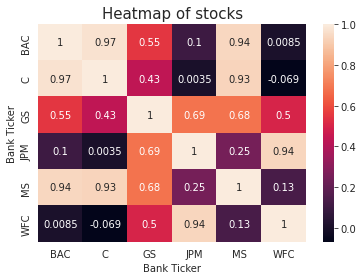

In [ ]:
#Creating a heatmap of stocks' close price

sns.heatmap(bank_stocks.xs(key='Close',axis=1,level='Stock Info').corr(),annot=True)
plt.title('Heatmap of stocks', fontdict={'size':15})

Text(0.5, 1.0, 'Clustermap of stocks')

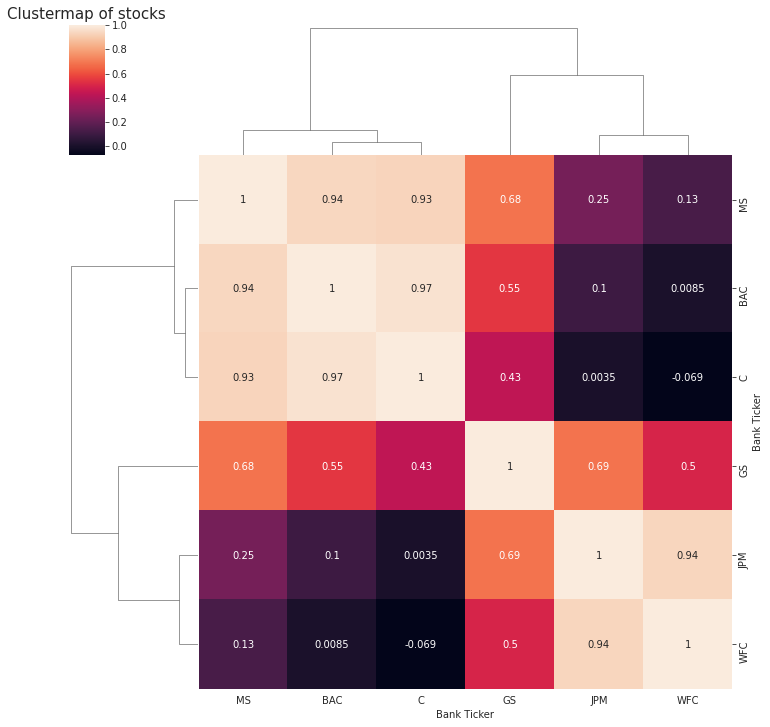

In [ ]:
sns.clustermap(bank_stocks.xs(key='Close',axis=1,level='Stock Info').corr(),annot=True)
plt.title('Clustermap of stocks', fontdict={'size':15})

In [ ]:
#Creating an interactive heatmap of stocks' close price

enable_plotly_in_cell()
close_corr = bank_stocks.xs(key='Close',axis=1,level='Stock Info').corr()
close_corr.iplot(kind='heatmap',colorscale='rdylbu')

There apppears to be a relationship between Bank of America, Morgan Stanley and Citigroup. Also between Wellsfargo and JP Morgan. A lot of things could be responsile for this, Finacial Analyst and historians would have a better understanding of this.

# Some Technical Analysis Plots


In [ ]:
# Craeting a candle plot of Bank of America's stock from Jan 1st 2015 to Jan 1st 2016.

enable_plotly_in_cell()
BAC[['Open', 'High', 'Low', 'Close']].loc['2015-01-01':'2016-01-01'].iplot(kind='candle')

In [ ]:
#Creating a Simple Moving Average plot of Morgan Stanley for the year 2015

enable_plotly_in_cell()
MS['Close'].loc['2015-01-01':'2016-01-01'].ta_plot(study='sma',periods=[13,21,55],title='Simple Moving Averages')

In [32]:
#Creating a Bollinger Band Plot for Bank of America for the year 2015.

enable_plotly_in_cell()
BAC['Close'].loc['2015-01-01':'2016-01-01'].ta_plot(study='boll')